# Analysis and Visualization for Migros-Denner chain
## Group Project / CA

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import plotly.express as px
import json

In [7]:
df = pd.read_csv('../data/df_switzerland_denner.csv')

In [8]:
df.columns

Index(['Address', 'Street Name', 'Zip Code', 'City', 'Canton', 'Country',
       'Latitude', 'Longitude', 'Rating', 'Number of Ratings', 'Place Name',
       'Place ID', 'Sunday_Open', 'Monday_Open', 'Tuesday_Open',
       'Wednesday_Open', 'Thursday_Open', 'Friday_Open', 'Saturday_Open',
       'Sunday_Close', 'Monday_Close', 'Tuesday_Close', 'Wednesday_Close',
       'Thursday_Close', 'Friday_Close', 'Saturday_Close'],
      dtype='object')

In [10]:
# Getting coordinates for cantons 
with open("../data/georef-switzerland-kanton@public.geojson") as response:
    cantons = json.load(response)

cantons["features"][0]["properties"]

{'geo_point_2d': {'lon': 8.756666184200009, 'lat': 47.061777487306394},
 'year': '2023',
 'kan_code': ['05'],
 'kan_name': ['Schwyz'],
 'kan_area_code': 'CHE',
 'kan_type': 'Kanton'}

In [11]:
df1 = df.copy()

In [12]:
cantons_dict = {'TG':'Thurgau', 'GR':'Graubünden', 'LU':'Luzern', 'BE':'Bern', 'VS':'Valais', 
                'BL':'Basel-Landschaft', 'SO':'Solothurn', 'VD':'Vaud', 'SH':'Schaffhausen', 'ZH':'Zürich', 
                'AG':'Aargau', 'UR':'Uri', 'NE':'Neuchâtel', 'TI':'Ticino', 'SG':'St. Gallen', 'GE':'Genève', 
                'GL':'Glarus', 'JU':'Jura', 'ZG':'Zug', 'OW':'Obwalden', 'FR':'Fribourg', 'SZ':'Schwyz', 
                'AR':'Appenzell Ausserrhoden', 'AI':'Appenzell Innerrhoden', 'NW':'Nidwalden', 'BS':'Basel-Stadt'}

In [12]:
denner_per_canton = df1.groupby('Canton').size().reset_index(name='count')
denner_per_canton

,Canton,count
0,Aargau,18
1,Basel-Landschaft,1
2,Basel-Stadt,18
3,Bern,21
4,Fribourg,8
5,Graubünden,20
6,Jura,4
7,Luzern,19
8,Neuchâtel,5
9,Nidwalden,4


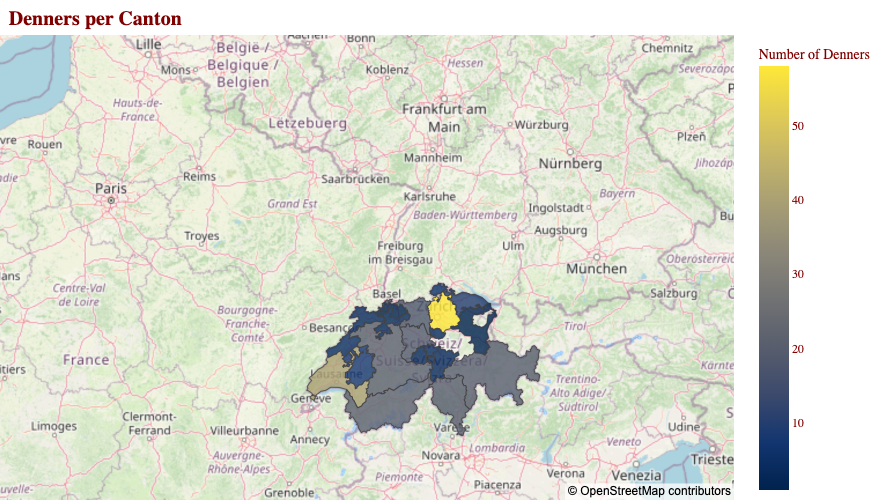

In [16]:
# mapping denners per canton
fig = px.choropleth_mapbox(
    denner_per_canton, 
    color="count",
    geojson=cantons, 
    locations="Canton", 
    featureidkey="properties.kan_name",
    center={"lat": 46.8, "lon": 8.3},
    mapbox_style="open-street-map", 
    zoom=6.3,
    opacity=0.8,
    width=900,
    height=500,
    labels={"Canton":"Canton",
           "count":"Number of Denners"},
    title="<b>Denners per Canton</b>",
    color_continuous_scale="Cividis",
)
fig.update_layout(margin={"r":0,"t":35,"l":0,"b":0},
                  font={"family":"Sans",
                       "color":"maroon"},
                  hoverlabel={"bgcolor":"white", 
                              "font_size":12,
                             "font_family":"Helvetica"},
                  title={"font_size":20,
                        "xanchor":"left", "x":0.01,
                        "yanchor":"bottom", "y":0.95}
                 )
fig.show()

In [20]:
rating_per_canton = df1.groupby('Canton')['Rating'].agg('mean').reset_index(name='mean_rating')
sorted_rating = rating_per_canton.sort_values(by='mean_rating', ascending=False)

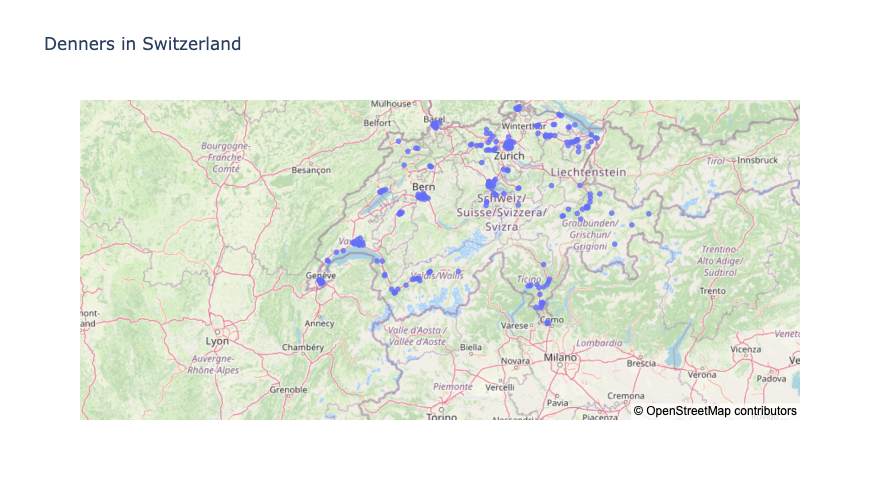

In [27]:
# Each denner on the map
fig = px.scatter_mapbox(df1, lat="Latitude", lon="Longitude", center={"lat": 46.8, "lon": 8.3},
    mapbox_style="open-street-map", 
    zoom=6.3,
    opacity=0.8,
    width=900,
    height=500,
    title="Denners in Switzerland")
    #labels={"Canton":"Canton"})

fig.show()

In [54]:
#population = pd.read_csv('../data/pop_denn.csv')
population.fillna(0, inplace=True)

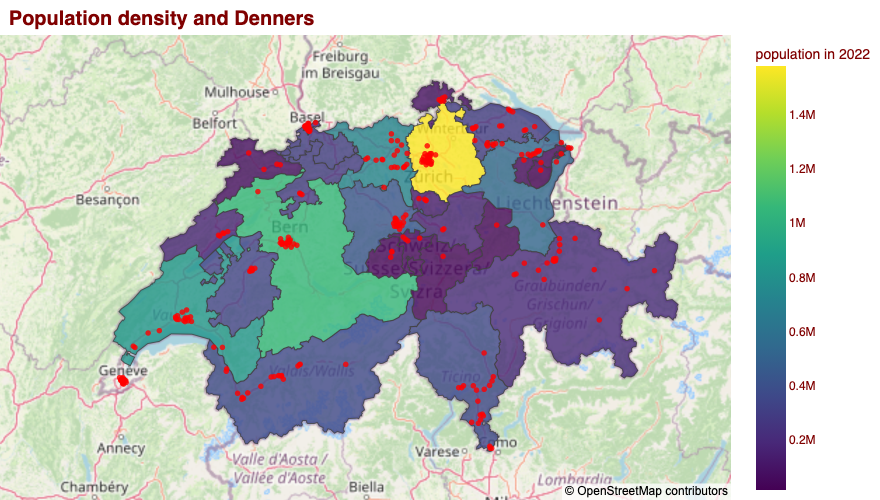

In [48]:
fig = px.choropleth_mapbox(
    population, 
    color='2022',
    color_continuous_scale='viridis',
    geojson=cantons, 
    locations="canton", 
    featureidkey="properties.kan_name",
    center={"lat": 46.8, "lon": 8.3},
    mapbox_style="open-street-map", 
    zoom=6.3,
    opacity=0.8,
    width=900,
    height=500,
    labels={"canton":"Canton",
           "2022":"population in 2022"},
    title="<b>Population density and Denners</b>"
    
)
fig.update_layout(margin={"r":0,"t":35,"l":0,"b":0},
                  font={"family":"Helvetica",
                       "color":"maroon"},
                  hoverlabel={"bgcolor":"white", 
                              "font_size":12,
                             "font_family":"Helvetica"},
                  title={"font_size":20,
                        "xanchor":"left", "x":0.01,
                        "yanchor":"bottom", "y":0.95}
                 )

fig2 = px.scatter_mapbox(df1, lat="Latitude", lon="Longitude",
                         size_max=15,  # Color the dots based on a column
                         color_discrete_sequence=["red"], # Choose a color scale
                         center={"lat": 46.8, "lon": 8.3},
                         mapbox_style="open-street-map", 
                         zoom=6.3,
                         opacity=0.8,
                         width=900,
                         height=500) 
trace0 = fig2 # the second map from the previous code
fig.add_trace(trace0.data[0])
trace0.layout.update(showlegend=False)
fig.show()

In [56]:
#population['2022'] = population['2022'].str.replace(',', '').astype(int)

## Analysis of population and projections

In [3]:
# Loading data on the population projection
#projection = pd.read_csv('projections_pop.csv')

In [19]:
# Percentage change calculation

#projection['per_change_10y'] = (projection['2030'] - projection['2020'])/projection['2020'] * 100
#projection['per_change_20y'] = (projection['2040'] - projection['2020'])/projection['2020'] * 100

In [5]:
#projection.to_csv('per_change.csv')

In [18]:
# Preparing data for the column chart on the projection of the population 
projection = pd.read_csv('../data/per_change.csv')
viz1 = projection[['Canton','per_change_10y', 'per_change_20y']]
viz1 = viz1.sort_values(by='per_change_20y', ascending=False)

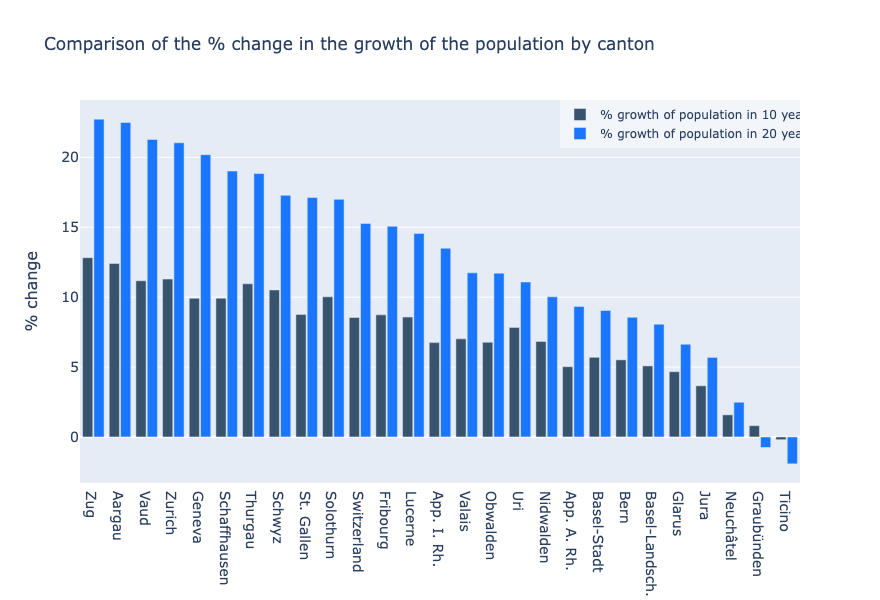

In [8]:
# Column chart for the 10 and 20 years population projection
fig = go.Figure()
fig.add_trace(go.Bar(x=viz1['Canton'],
                y=viz1['per_change_10y'],
                name='% growth of population in 10 years',
                marker_color='rgb(55, 83, 109)'
                ))
fig.add_trace(go.Bar(x=viz1['Canton'],
                y=viz1['per_change_20y'],
                name='% growth of population in 20 years',
                marker_color='rgb(26, 118, 255)'
                ))

fig.update_layout(
    title='Comparison of the % change in the growth of the population by canton',
    xaxis_tickfont_size=14,
    yaxis=dict(
        title='% change',
        titlefont_size=16,
        tickfont_size=14,
    ),
    legend=dict(
        x=0,
        y=1.0,
        bgcolor='rgba(255, 255, 255, 0)',
        bordercolor='rgba(255, 255, 255, 0)'
    ),
    barmode='group',
    bargap=0.15, # gap between bars of adjacent location coordinates.
    bargroupgap=0.1,
    width=1000, # Set the width of the figure
    height=600 # gap between bars of the same location coordinate.
)

fig.update_layout(
    legend=dict(
        x=1,
        y=1,
        xanchor='right',  # Anchors the legend to the right
        yanchor='top',
        bgcolor='rgba(255, 255, 255, 0.5)'  # Anchors the legend to the bottom
    )
)

fig.show()

In [21]:
df_migros = pd.read_csv('../data/df_switzerland_migros.csv')

In [22]:
df_migros.head()

,Type,Store ID,Name,Address,Opening Hour,Zip Code,City,Canton
0,M-Migros,90320,Aachtal,"Schrofenstrasse 19, 8580 Amriswil",NaN,8580,Amriswil,Zürich
1,M-Migros,93780,Aadorf,"Bahnhofstrasse 2, 8355 Aadorf",NaN,8355,Aadorf,Zürich
2,MM-Migros,34213,Aarau - Igelweid,"Igelweid 18, 5000 Aarau",NaN,5000,Aarau,Aargau
3,M-Migros,33823,Aarau Bahnhof,"Bahnhofplatz 3h, 5000 Aarau",NaN,5000,Aarau,Aargau
4,MM-Migros,90491,Abtwil - Säntispark,"Wiesenbachstrasse 7, 9030 Abtwil SG",NaN,9030,Abtwil,Zürich


In [23]:
pip install geopy


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 125.4/125.4 kB 4.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.3/40.3 kB 4.0 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


In [24]:
from geopy.geocoders import Nominatim
from geopy.extra.rate_limiter import RateLimiter

In [ ]:
# Initialize the geolocator
# Adjust the timeout for the geocode call
geocode = RateLimiter(geolocator.geocode, min_delay_seconds=1, error_wait_seconds=10)

# You might also need to adjust the geolocator's timeout directly
geolocator = Nominatim(user_agent="geoapiExercises", timeout=10)  # Increase timeout to 10 seconds

# Define a function to get longitude and latitude for a given address
def get_lat_lon(address):
    try:
        location = geocode(address)
        return location.latitude, location.longitude
    except:
        # In case the geocoding fails, return NaN or some indication
        return None, None

# Apply the function to your DataFrame
df['latitude'], df['longitude'] = zip(*df_migros['Address'].apply(get_lat_lon))

In [26]:
df_migros.head()

,Type,Store ID,Name,Address,Opening Hour,Zip Code,City,Canton
0,M-Migros,90320,Aachtal,"Schrofenstrasse 19, 8580 Amriswil",NaN,8580,Amriswil,Zürich
1,M-Migros,93780,Aadorf,"Bahnhofstrasse 2, 8355 Aadorf",NaN,8355,Aadorf,Zürich
2,MM-Migros,34213,Aarau - Igelweid,"Igelweid 18, 5000 Aarau",NaN,5000,Aarau,Aargau
3,M-Migros,33823,Aarau Bahnhof,"Bahnhofplatz 3h, 5000 Aarau",NaN,5000,Aarau,Aargau
4,MM-Migros,90491,Abtwil - Säntispark,"Wiesenbachstrasse 7, 9030 Abtwil SG",NaN,9030,Abtwil,Zürich


In [27]:
migros_per_canton = df_migros.groupby('Canton').size().reset_index(name='count')

In [32]:
migros_per_canton['count'] = migros_per_canton['count']
migros_per_canton.drop(['count'], axis=1, inplace=True)
migros_per_canton

,Canton,count_mig
0,Aargau,70
1,Basel-Landschaft,29
2,Basel-Stadt,25
3,Bern,105
4,Fribourg,27
5,Genève,35
6,Graubünden,13
7,Jura,3
8,Lucerne,1
9,Luzern,31


In [33]:
migros_per_canton.merge(denner_per_canton, how=)

,Canton,count_mig,count
0,Aargau,70,18
1,Basel-Landschaft,29,1
2,Basel-Stadt,25,18
3,Bern,105,21
4,Fribourg,27,8
5,Graubünden,13,20
6,Jura,3,4
7,Luzern,31,19
8,Neuchâtel,16,5
9,Nidwalden,4,4


In [79]:
merged_df = pd.merge(migros_per_canton, denner_per_canton, on='Canton', how='left')
merged_df.fillna(0, inplace=True)
merged_df

,Canton,count_mig,count
0,Aargau,70,18.0
1,Basel-Landschaft,29,1.0
2,Basel-Stadt,25,18.0
3,Bern,105,21.0
4,Fribourg,27,8.0
5,Genève,35,0.0
6,Graubünden,13,20.0
7,Jura,3,4.0
8,Lucerne,1,0.0
9,Luzern,31,19.0


In [80]:
merged_df['counts'] = merged_df['count'] + merged_df['count_mig']
merged_df

,Canton,count_mig,count,counts
0,Aargau,70,18.0,88.0
1,Basel-Landschaft,29,1.0,30.0
2,Basel-Stadt,25,18.0,43.0
3,Bern,105,21.0,126.0
4,Fribourg,27,8.0,35.0
5,Genève,35,0.0,35.0
6,Graubünden,13,20.0,33.0
7,Jura,3,4.0,7.0
8,Lucerne,1,0.0,1.0
9,Luzern,31,19.0,50.0


In [39]:
migros_geo = pd.read_csv('../data/df_switzerland_migros_geocoded.csv')
migros_geo

,Type,Store ID,Name,Address,Opening Hour,Zip Code,City,Canton,Longitude,Latitude
0,M-Migros,90320,Aachtal,"Schrofenstrasse 19, 8580 Amriswil",NaN,8580,Amriswil,Zürich,9.273352,47.548199
1,M-Migros,93780,Aadorf,"Bahnhofstrasse 2, 8355 Aadorf",NaN,8355,Aadorf,Zürich,8.899659,47.490191
2,MM-Migros,34213,Aarau - Igelweid,"Igelweid 18, 5000 Aarau",NaN,5000,Aarau,Aargau,8.046135,47.391730
3,M-Migros,33823,Aarau Bahnhof,"Bahnhofplatz 3h, 5000 Aarau",NaN,5000,Aarau,Aargau,8.052871,47.391848
4,MM-Migros,90491,Abtwil - Säntispark,"Wiesenbachstrasse 7, 9030 Abtwil SG",NaN,9030,Abtwil,Zürich,9.316521,47.417799
...,...,...,...,...,...,...,...,...,...,...
767,MM-Migros,150008,Zürich - Wollishofen,"Etzelstrasse 3, 8038 Zürich",NaN,8038,Zürich,Zürich,8.530000,47.344722
768,Migros-Supermarkt,93020,teo Bürglen,"Weinfelderstrasse 33a, 8575 Bürglen",NaN,8575,Bürglen,Zürich,9.145786,47.552979
769,Migros-Supermarkt,150261,teo Dietlikon,"Brunnenwiesenstrasse 22, 8305 Dietlikon",NaN,8305,Dietlikon,Zürich,8.620283,47.417121
770,Migros-Supermarkt,150260,teo Kloten,"Lindenstrasse 18, 8302 Kloten",NaN,8302,Kloten,Zürich,8.584455,47.448946


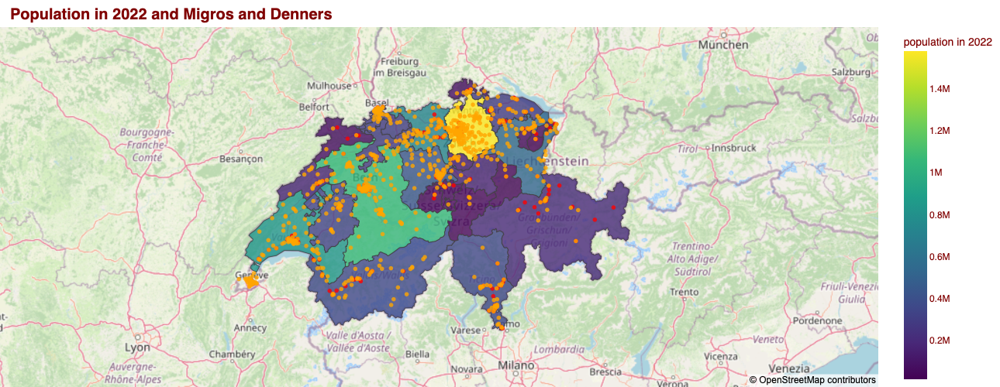

In [46]:
# Map of Migros + Denners on the population density in 2022

fig = px.choropleth_mapbox(
    population, 
    color='2022',
    color_continuous_scale='viridis',
    geojson=cantons, 
    locations="canton", 
    featureidkey="properties.kan_name",
    center={"lat": 46.8, "lon": 8.3},
    mapbox_style="open-street-map", 
    zoom=6.3,
    opacity=0.8,
    width=900,
    height=500,
    labels={"canton":"Canton",
           "2022":"population in 2022"},
    title="<b>Population in 2022 and Migros and Denners</b>"
    
)
fig.update_layout(margin={"r":0,"t":35,"l":0,"b":0},
                  font={"family":"Helvetica",
                       "color":"maroon"},
                  hoverlabel={"bgcolor":"white", 
                              "font_size":12,
                             "font_family":"Helvetica"},
                  title={"font_size":20,
                        "xanchor":"left", "x":0.01,
                        "yanchor":"bottom", "y":0.95}
                 )

fig2 = px.scatter_mapbox(df1, lat="Latitude", lon="Longitude",
                         size_max=15,  # Color the dots based on a column
                         color_discrete_sequence=["red"], # Choose a color scale
                         center={"lat": 46.8, "lon": 8.3},
                         mapbox_style="open-street-map", 
                         zoom=6.3,
                         opacity=0.8,
                         width=900,
                         height=500) 

fig3 = px.scatter_mapbox(migros_geo, lat="Latitude", lon="Longitude",
                         size_max=15,  # Color the dots based on a column
                         color_discrete_sequence=["orange"], # Choose a color scale
                         center={"lat": 46.8, "lon": 8.3},
                         mapbox_style="open-street-map", 
                         zoom=6.3,
                         opacity=0.8,
                         width=900,
                         height=500) 
trace0 = fig2
trace1 = fig3# the second map from the previous code
fig.add_trace(trace0.data[0])
fig.add_trace(trace1.data[0])
trace0.layout.update(showlegend=True)
trace1.layout.update(showlegend=True)
fig.show()

In [61]:
population

,canton,2022,denners
0,Vaud,830431,40.0
1,Valais,357282,21.0
2,Geneva,514114,0.0
3,Bern,1051437,21.0
4,Fribourg,334465,8.0
5,Solothurn,282408,3.0
6,Neuchâtel,176571,5.0
7,Jura,73865,4.0
8,Basel-Stadt,196786,18.0
9,Basel-Landschaft,294417,1.0


In [84]:
#merged_df = merged_df.drop(columns=['count_mig', 'count'])
#merged_df.rename(columns={'Canton': 'canton'}, inplace=True)
merged_df['canton'] = merged_df['canton'].replace('Genève', 'Geneve')
merged_df

,canton,counts
0,Aargau,88.0
1,Basel-Landschaft,30.0
2,Basel-Stadt,43.0
3,Bern,126.0
4,Fribourg,35.0
5,Geneve,35.0
6,Graubünden,33.0
7,Jura,7.0
8,Lucerne,1.0
9,Luzern,50.0


In [103]:
pop_index1 = pd.merge(population, merged_df, on='canton', how='left' )
pop_index1.fillna(0, inplace=True)

In [104]:
pop_index1['shop_rate'] = round(((pop_index1['counts'] / pop_index1['2022']) * 10000), 1)
pop_index1

,canton,2022,denners,counts,shop_rate
0,Vaud,830431,40.0,112.0,1.3
1,Valais,357282,21.0,64.0,1.8
2,Geneva,514114,0.0,0.0,0.0
3,Bern,1051437,21.0,126.0,1.2
4,Fribourg,334465,8.0,35.0,1.0
5,Solothurn,282408,3.0,27.0,1.0
6,Neuchâtel,176571,5.0,21.0,1.2
7,Jura,73865,4.0,7.0,0.9
8,Basel-Stadt,196786,18.0,43.0,2.2
9,Basel-Landschaft,294417,1.0,30.0,1.0


In [110]:
pop_index1 = pop_index1.sort_values(by='shop_rate', ascending=False)
pop_index_top5 = pop_index1.iloc[:6]

pop_index_top5.to_csv('../data/pop_index_top5.csv')

In [111]:
top5_index = pd.read_csv('../data/pop_index_top5.csv')
top5_index

,Unnamed: 0,canton,2022,denners,counts,shop_rate
0,8,Basel-Stadt,196786,18.0,43.0,2.2
1,23,Nidwalden,44420,4.0,8.0,1.8
2,1,Valais,357282,21.0,64.0,1.8
3,11,Zürich,1579967,58.0,278.0,1.8
4,20,Uri,37317,3.0,6.0,1.6
5,17,Graubünden,202538,20.0,33.0,1.6


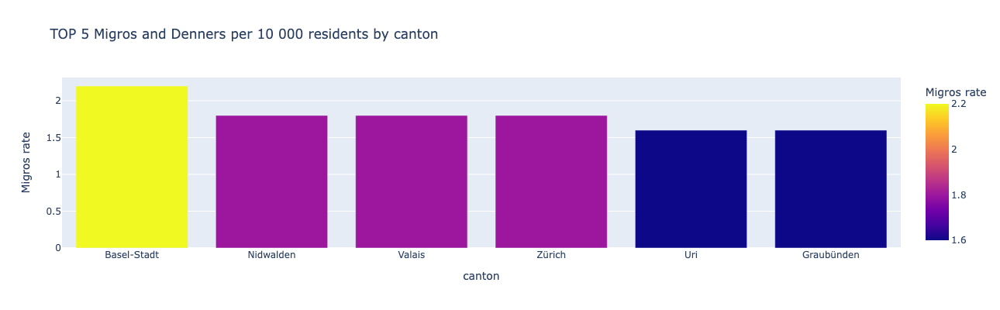

In [113]:
fig = px.bar(top5_index, x='canton', y='shop_rate',
             hover_data=['canton'], color='shop_rate',
             labels={'shop_rate':'Migros rate'}, height=400, width=600,
            title='TOP 5 Migros and Denners per 10 000 residents by canton')
fig.show()